# N1_Native folder

Otsu threshold value: 0.059659454990001456


C:\Users\Dani\AppData\Local\Temp\ipykernel_9500\2717785999.py:62: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  closed = closing(thresh, square(3))


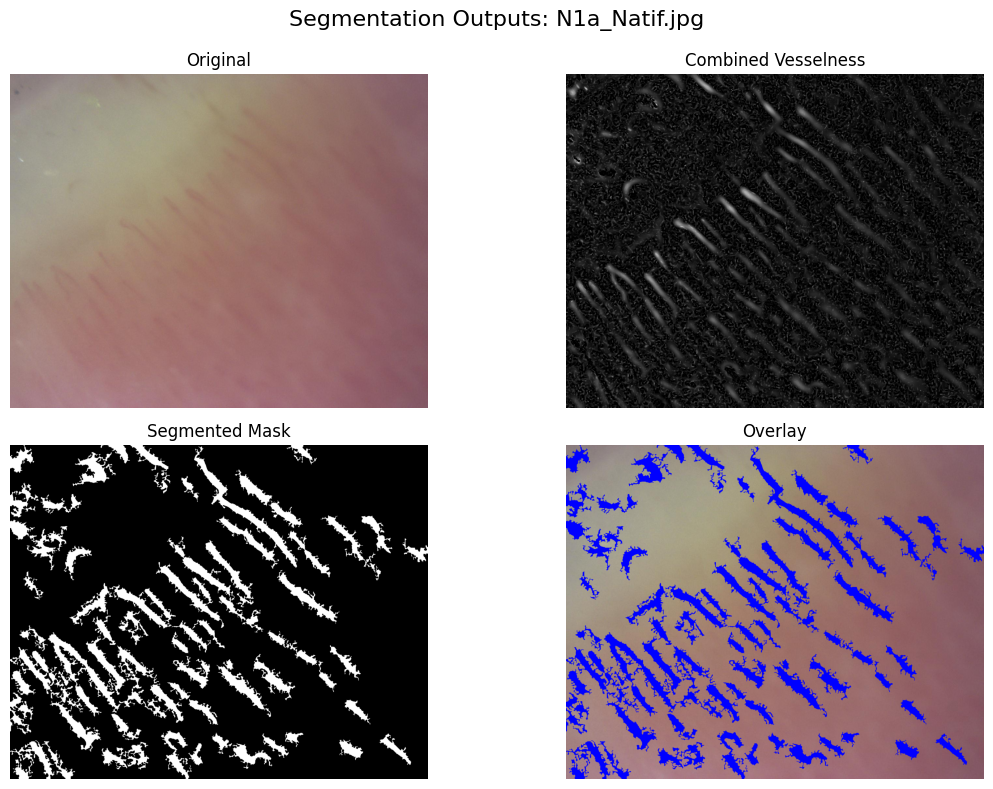

Otsu threshold value: 0.06338941859127067


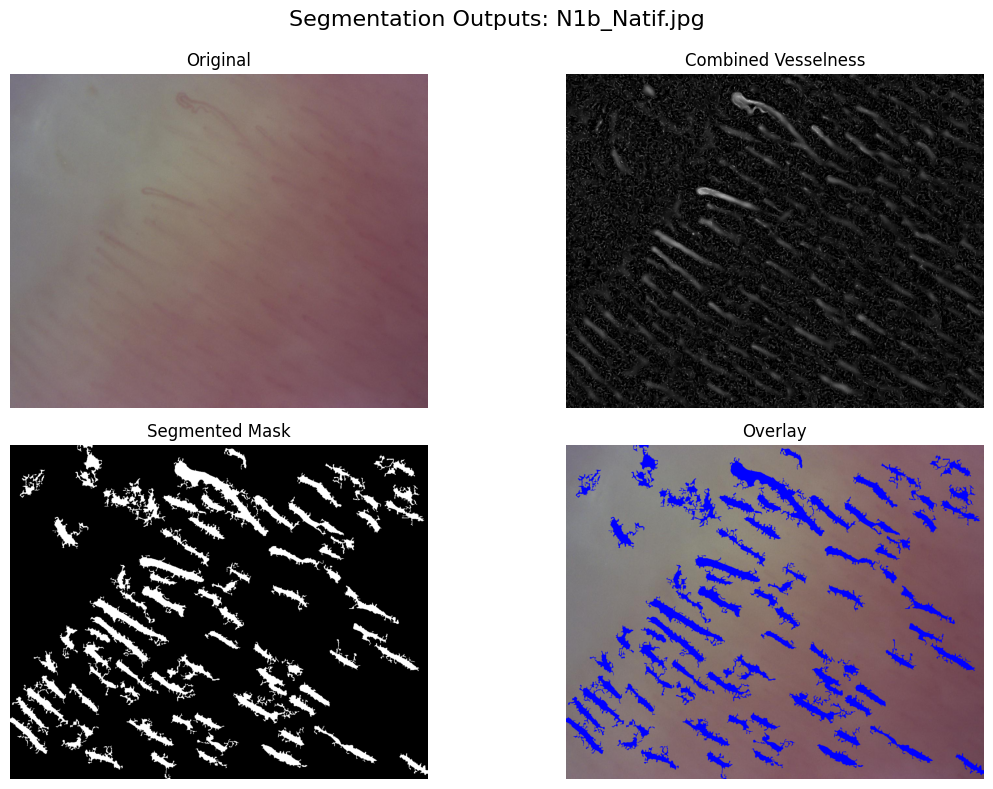

Otsu threshold value: 0.0561973345296623


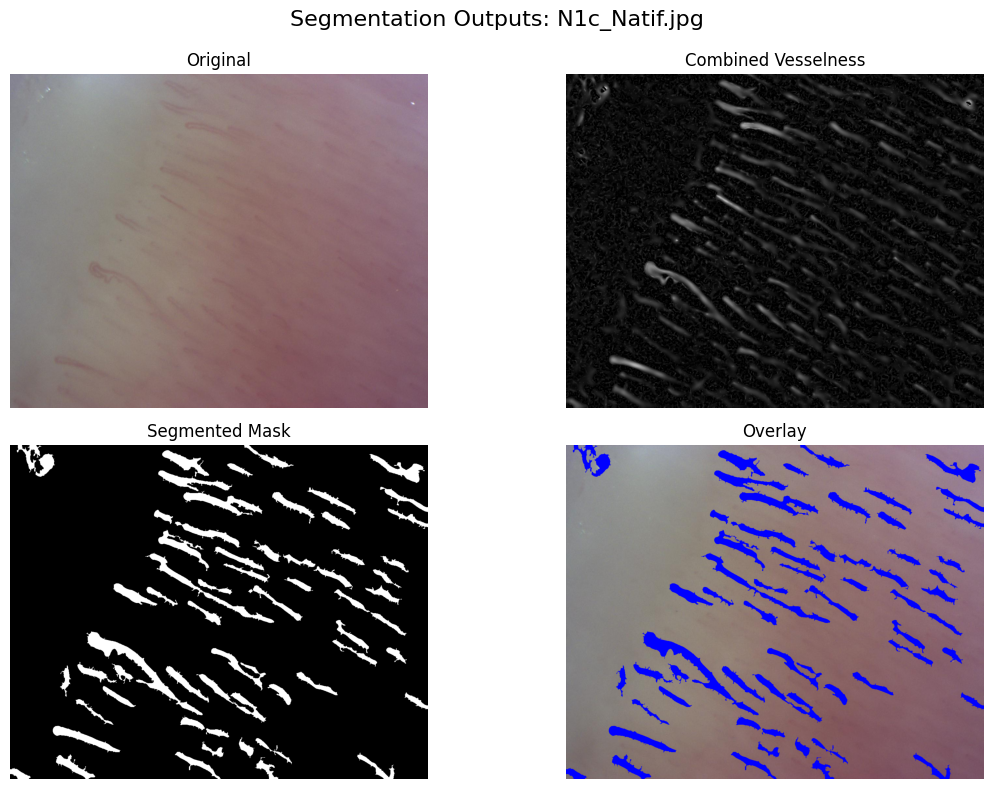

Otsu threshold value: 0.05014298681426714


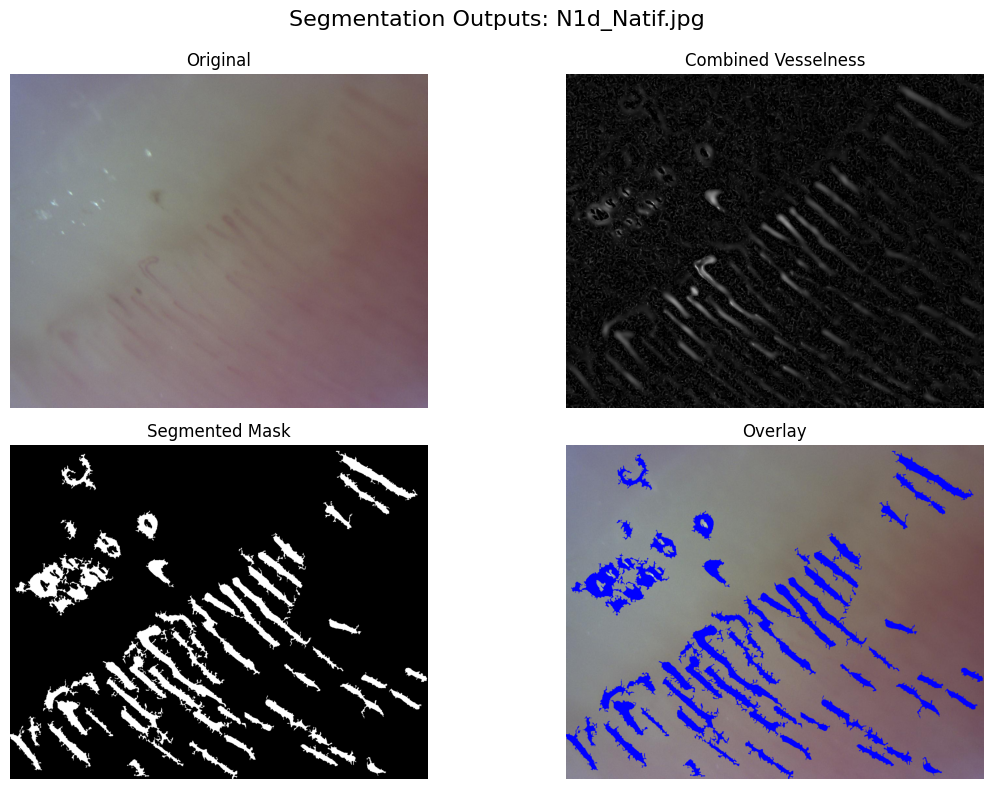

Otsu threshold value: 0.05492601651620867


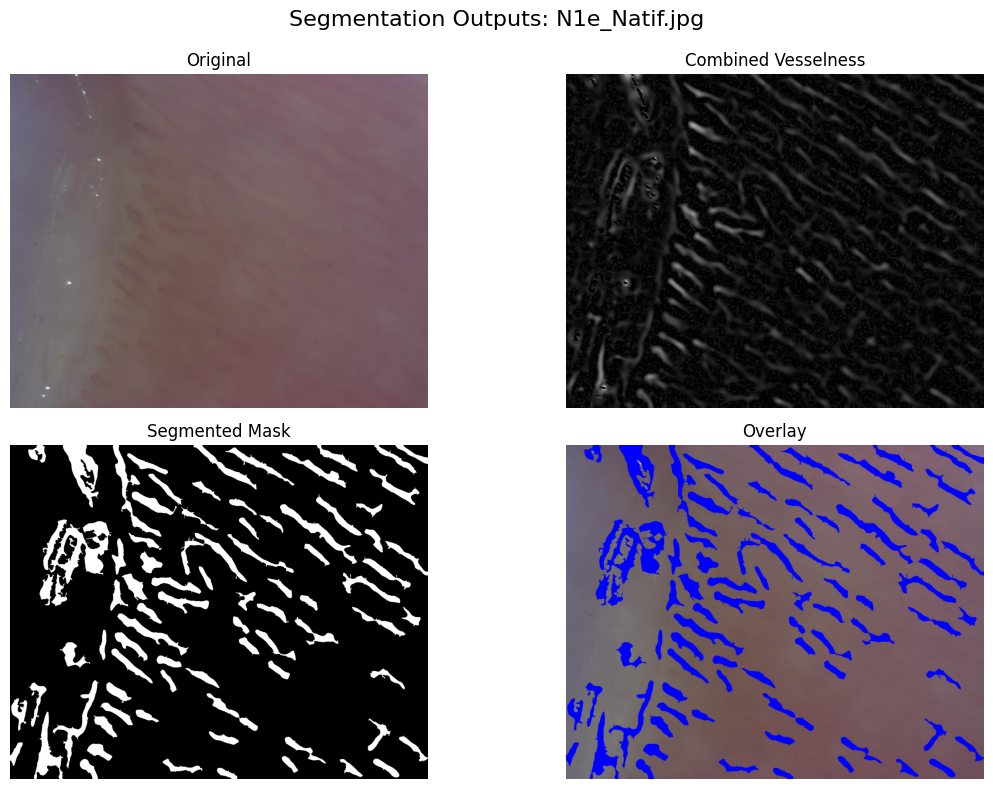

Otsu threshold value: 0.0498058550527086


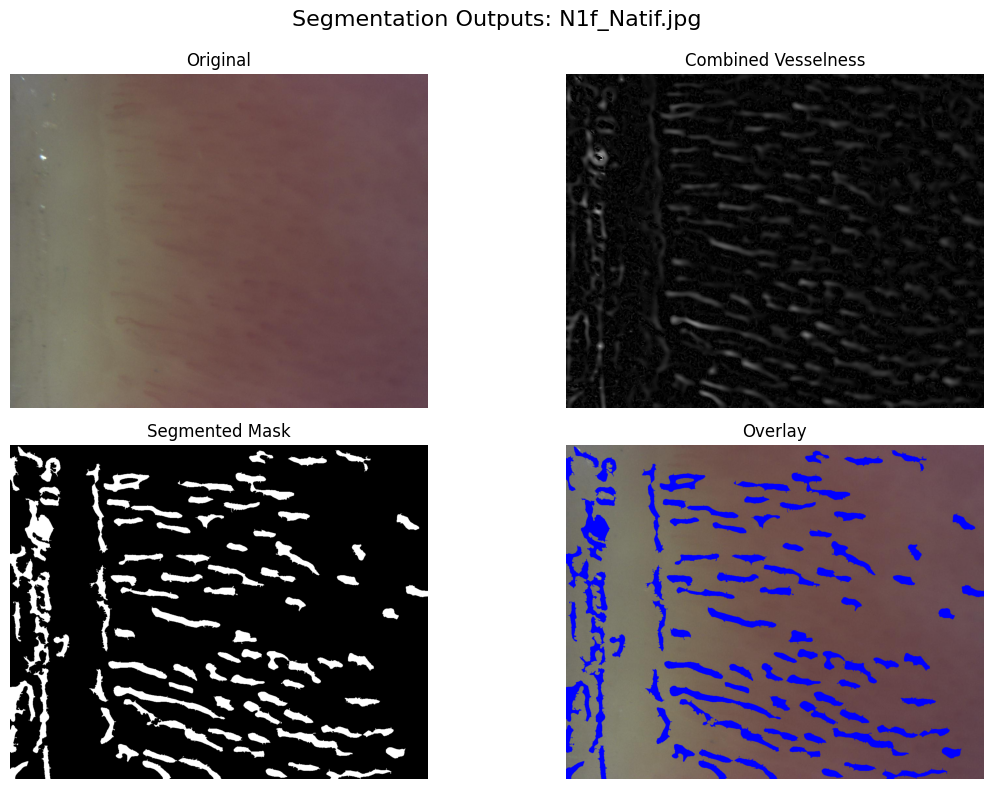

Otsu threshold value: 0.0498058550527086


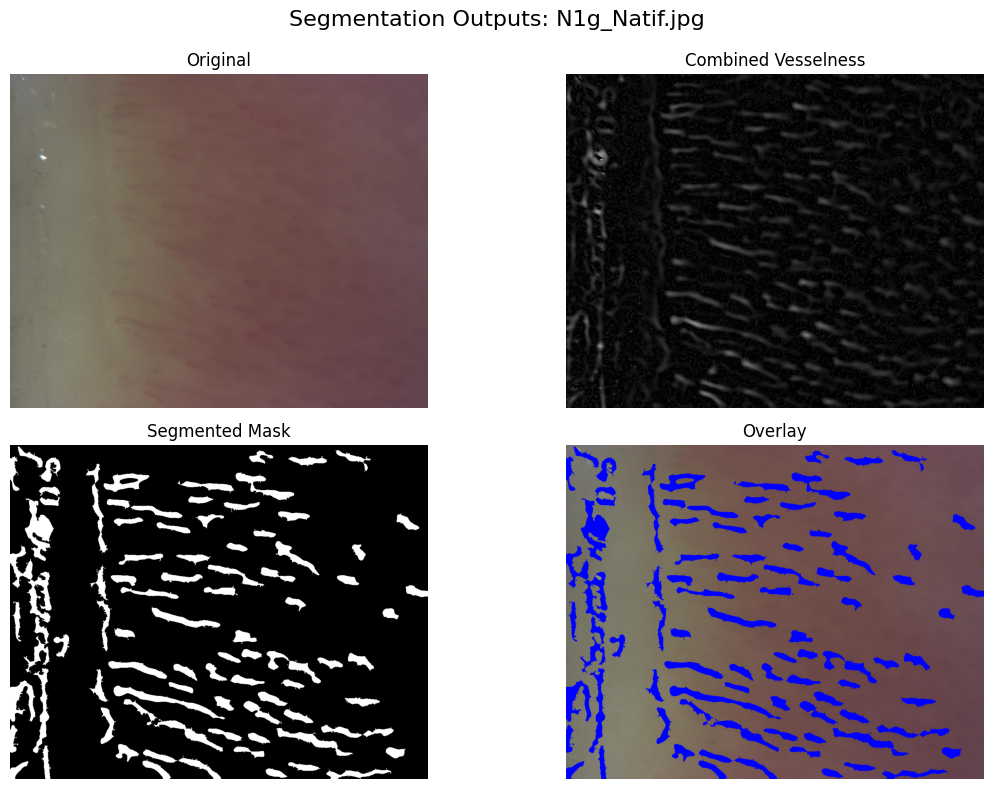

Otsu threshold value: 0.04771261210168478


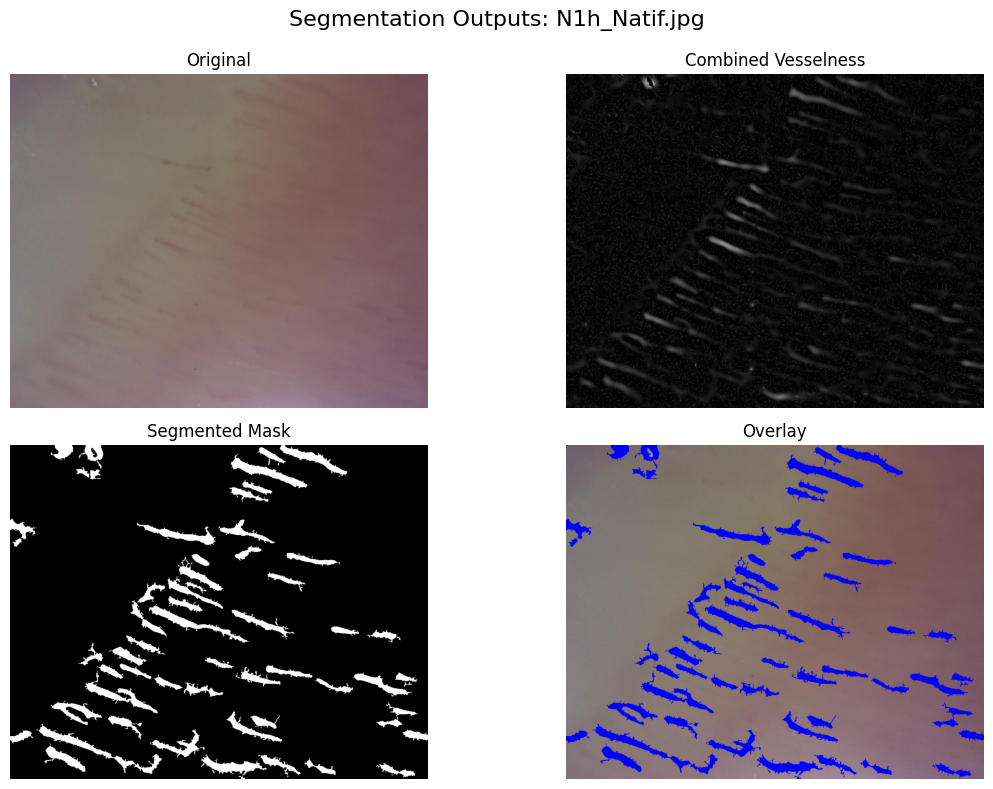

Otsu threshold value: 0.043804222402702736


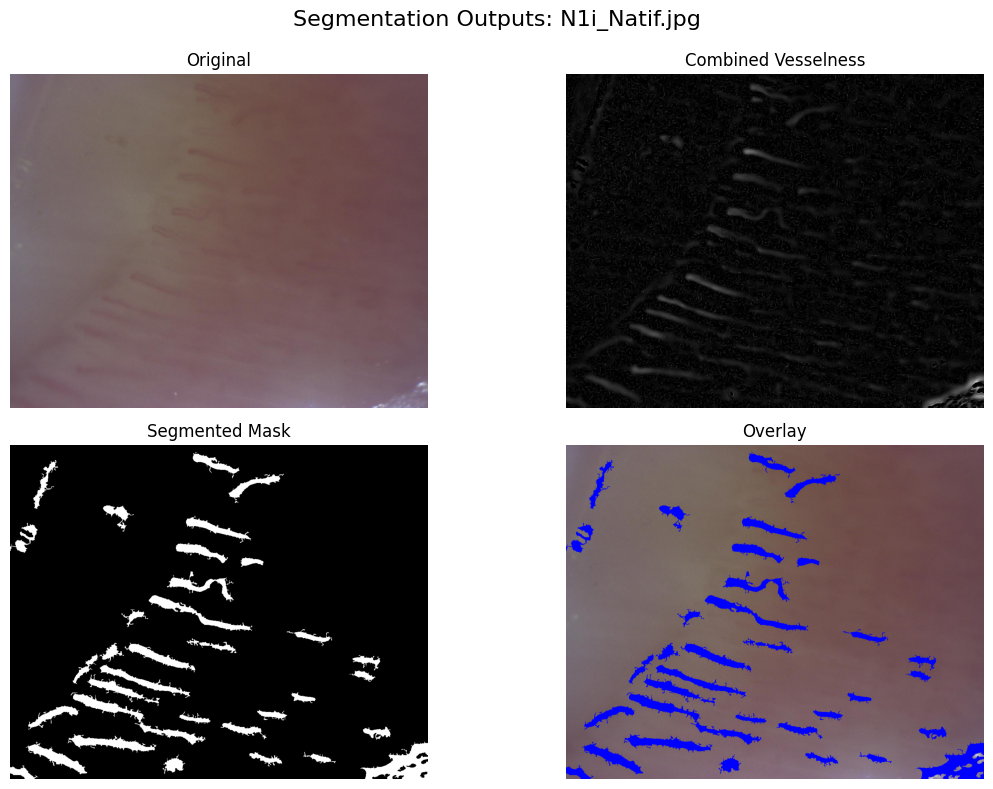

Otsu threshold value: 0.0723280562367497


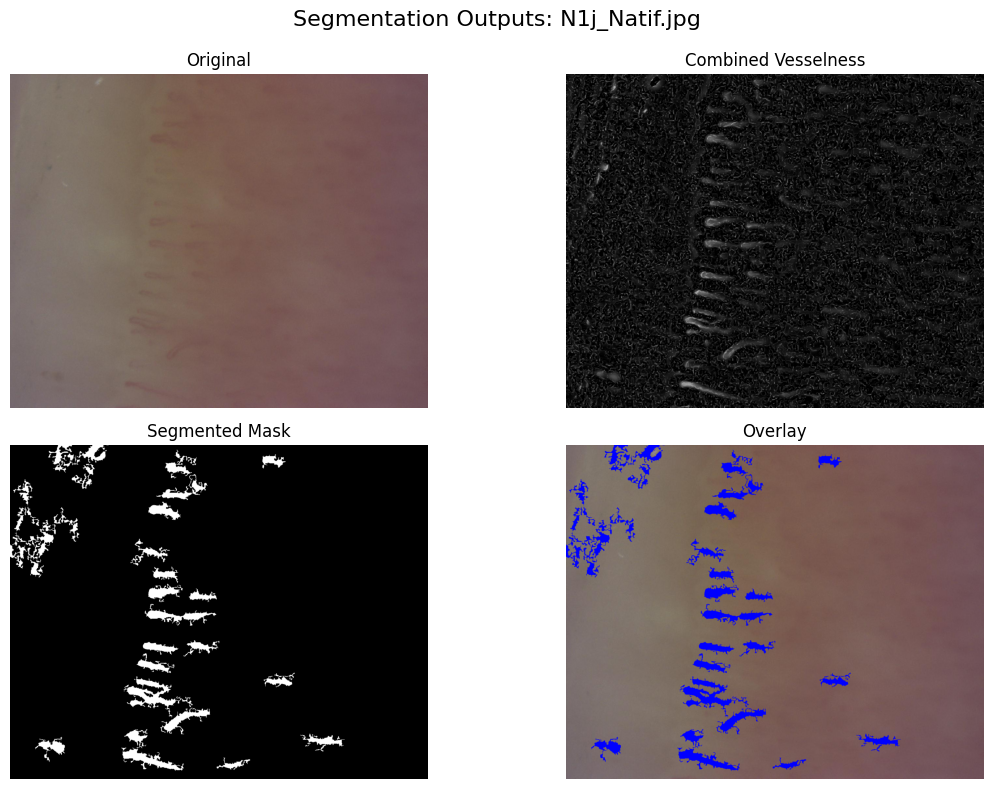

In [73]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, meijering, sato, threshold_otsu
from skimage.morphology import remove_small_objects, closing, square, remove_small_holes
from matplotlib.backends.backend_pdf import PdfPages

# Path to your N1_Native folder
folder_path = 'Dataset/Native/N1_Native'

# New organized output folders
base_output = 'Segmented'
segmentation_folder = os.path.join(base_output, 'N1_Native_Segmentation')

original_folder = os.path.join(segmentation_folder, 'Original')
vesselness_folder = os.path.join(segmentation_folder, 'Vesselness')
mask_folder = os.path.join(segmentation_folder, 'Masks')
overlay_folder = os.path.join(segmentation_folder, 'Overlays')

# Create folders
os.makedirs(original_folder, exist_ok=True)
os.makedirs(vesselness_folder, exist_ok=True)
os.makedirs(mask_folder, exist_ok=True)
os.makedirs(overlay_folder, exist_ok=True)

# Supported image formats
supported_extensions = ('.png', '.jpg', '.jpeg', '.tif')
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(supported_extensions)]

def segment_capillaries(img):
    # Convert to grayscale
    if len(img.shape) == 3:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img

    # Median filtering
    img_denoised = cv2.medianBlur(img_gray, 5)

    # Apply CLAHE
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_denoised)

    # Normalize to [0, 1]
    img_rescale = img_clahe / 255.0

    # Vessel enhancement filters
    v_frangi = frangi(img_rescale)
    v_sato = sato(img_rescale)
    v_meijering = meijering(img_rescale)

    # Combine vessel responses
    vessels = (v_frangi + v_sato + v_meijering) / 3.0

    # Otsu threshold
    otsu_thresh = threshold_otsu(vessels)
    thresh = vessels > otsu_thresh
    print(f"Otsu threshold value: {otsu_thresh}")

    # Morphological cleaning
    closed = closing(thresh, square(3))
    cleaned = remove_small_objects(closed, min_size=1000)
    cleaned = remove_small_holes(cleaned, area_threshold=200)

    return vessels, cleaned

# Process each image
for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    img = cv2.imread(img_path)

    vessels, segmented = segment_capillaries(img)

    # Overlay mask on original image
    overlay = img.copy()
    overlay[segmented.astype(bool)] = [255, 0, 0]  # Red overlay

    # Save original
    cv2.imwrite(os.path.join(original_folder, img_name), img)

    # Save vesselness
    vesselness_uint8 = (vessels * 255).astype(np.uint8)
    cv2.imwrite(os.path.join(vesselness_folder, img_name), vesselness_uint8)

    # Save binary mask
    cv2.imwrite(os.path.join(mask_folder, img_name), (segmented * 255).astype(np.uint8))

    # Save overlay
    cv2.imwrite(os.path.join(overlay_folder, img_name), overlay)

    # Optional: Display results
    plt.figure(figsize=(12, 8))
    plt.suptitle(f"Segmentation Outputs: {img_name}", fontsize=16)

    plt.subplot(2, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(vessels, cmap='gray')
    plt.title("Combined Vesselness")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(segmented, cmap='gray')
    plt.title("Segmented Mask")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title("Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


# N2_Native folder

Otsu threshold value: 0.04158979783158588


C:\Users\Dani\AppData\Local\Temp\ipykernel_3964\2766532223.py:63: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  closed = closing(thresh, square(3))


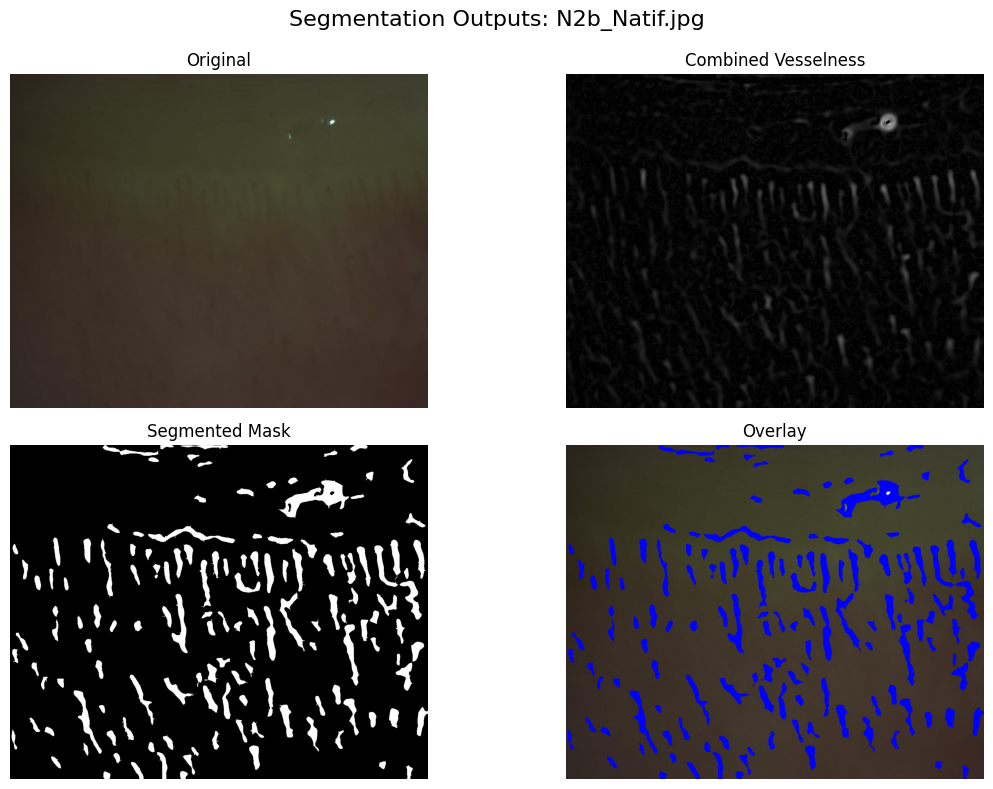

Otsu threshold value: 0.05749665754472008


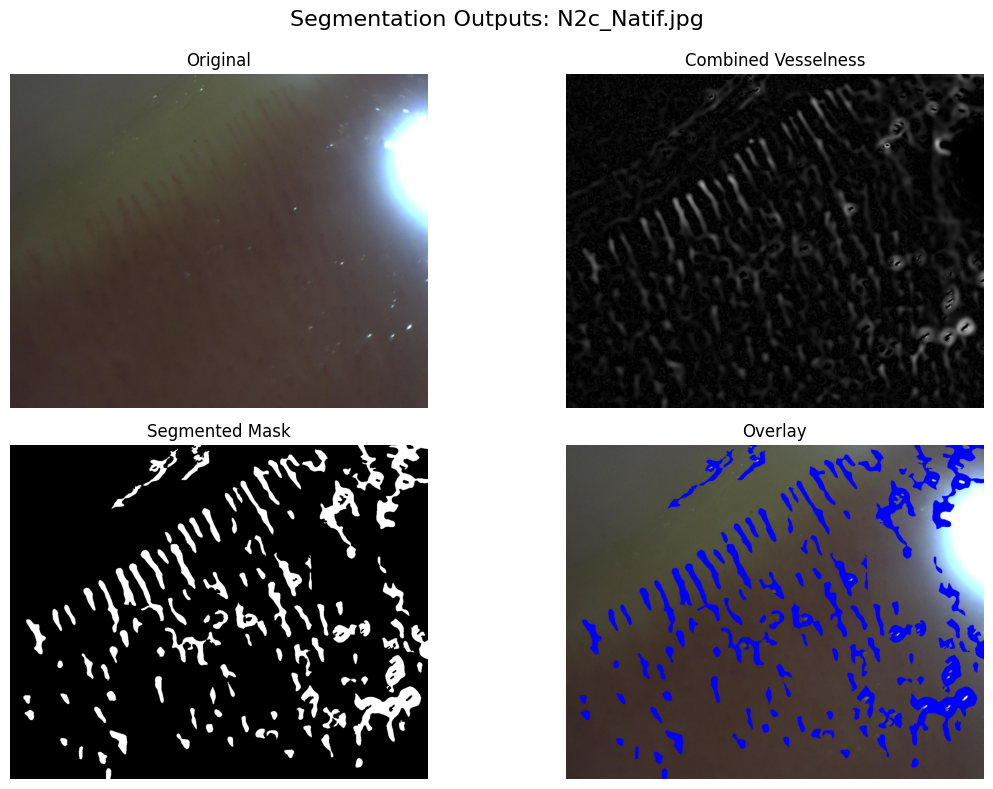

Otsu threshold value: 0.04101367935883073


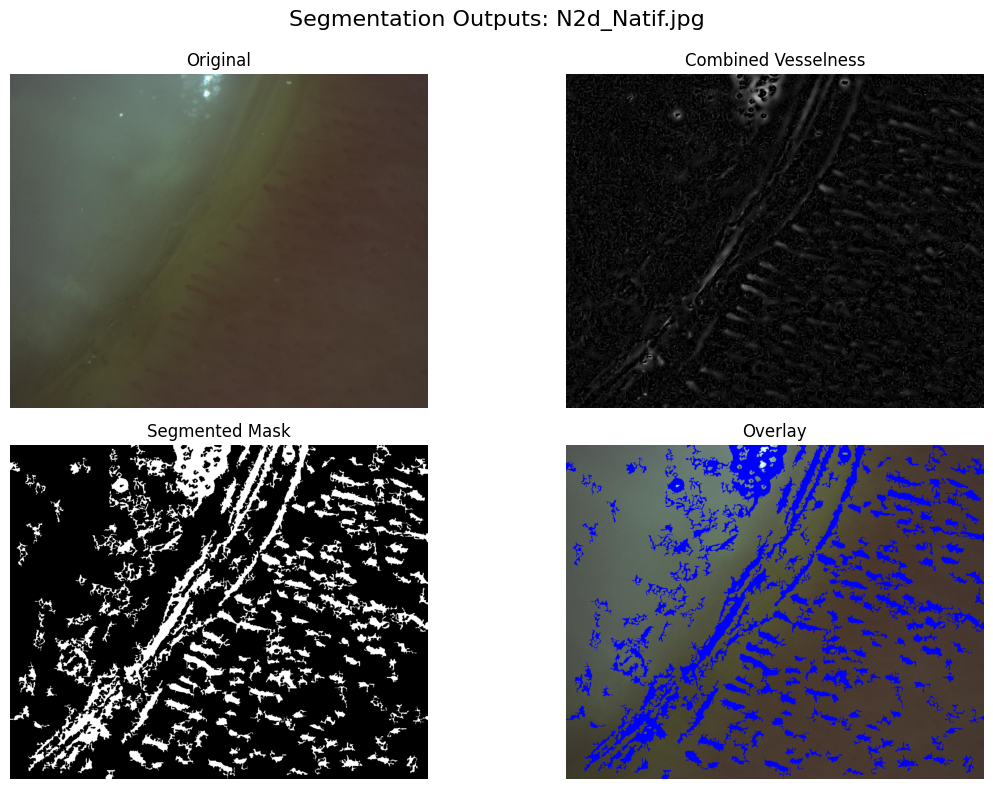

In [2]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, meijering, sato, threshold_otsu
from skimage.morphology import remove_small_objects, closing, square, remove_small_holes
from matplotlib.backends.backend_pdf import PdfPages


# Path to your N2_Native folder
folder_path = 'Dataset/Native/N2_Native'

# New organized output folders
base_output = 'Segmented'
segmentation_folder = os.path.join(base_output, 'N2_Native_Segmentation')

original_folder = os.path.join(segmentation_folder, 'Original')
vesselness_folder = os.path.join(segmentation_folder, 'Vesselness')
mask_folder = os.path.join(segmentation_folder, 'Masks')
overlay_folder = os.path.join(segmentation_folder, 'Overlays')

# Create folders
os.makedirs(original_folder, exist_ok=True)
os.makedirs(vesselness_folder, exist_ok=True)
os.makedirs(mask_folder, exist_ok=True)
os.makedirs(overlay_folder, exist_ok=True)

# Supported image formats
supported_extensions = ('.png', '.jpg', '.jpeg', '.tif')
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(supported_extensions)]

def segment_capillaries(img):
    # Convert to grayscale
    if len(img.shape) == 3:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img

    # Median filtering
    img_denoised = cv2.medianBlur(img_gray, 5)

    # Apply CLAHE
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_denoised)

    # Normalize to [0, 1]
    img_rescale = img_clahe / 255.0

    # Vessel enhancement filters
    v_frangi = frangi(img_rescale)
    v_sato = sato(img_rescale)
    v_meijering = meijering(img_rescale)

    # Combine vessel responses
    vessels = (v_frangi + v_sato + v_meijering) / 3.0

    # Otsu threshold
    otsu_thresh = threshold_otsu(vessels)
    thresh = vessels > otsu_thresh
    print(f"Otsu threshold value: {otsu_thresh}")

    # Morphological cleaning
    closed = closing(thresh, square(3))
    cleaned = remove_small_objects(closed, min_size=300)
    cleaned = remove_small_holes(cleaned, area_threshold=50)

    return vessels, cleaned

# Process each image
for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    img = cv2.imread(img_path)

    vessels, segmented = segment_capillaries(img)

    # Overlay mask on original image
    overlay = img.copy()
    overlay[segmented.astype(bool)] = [255, 0, 0]  # Red overlay

    # Save original
    cv2.imwrite(os.path.join(original_folder, img_name), img)

    # Save vesselness
    vesselness_uint8 = (vessels * 255).astype(np.uint8)
    cv2.imwrite(os.path.join(vesselness_folder, img_name), vesselness_uint8)

    # Save binary mask
    cv2.imwrite(os.path.join(mask_folder, img_name), (segmented * 255).astype(np.uint8))

    # Save overlay
    cv2.imwrite(os.path.join(overlay_folder, img_name), overlay)

    # Optional: Display results
    plt.figure(figsize=(12, 8))
    plt.suptitle(f"Segmentation Outputs: {img_name}", fontsize=16)

    plt.subplot(2, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(vessels, cmap='gray')
    plt.title("Combined Vesselness")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(segmented, cmap='gray')
    plt.title("Segmented Mask")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title("Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


# S2_Native

Otsu threshold value: 0.06746673653390534


C:\Users\Dani\AppData\Local\Temp\ipykernel_3964\3077874836.py:63: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  closed = closing(thresh, square(3))


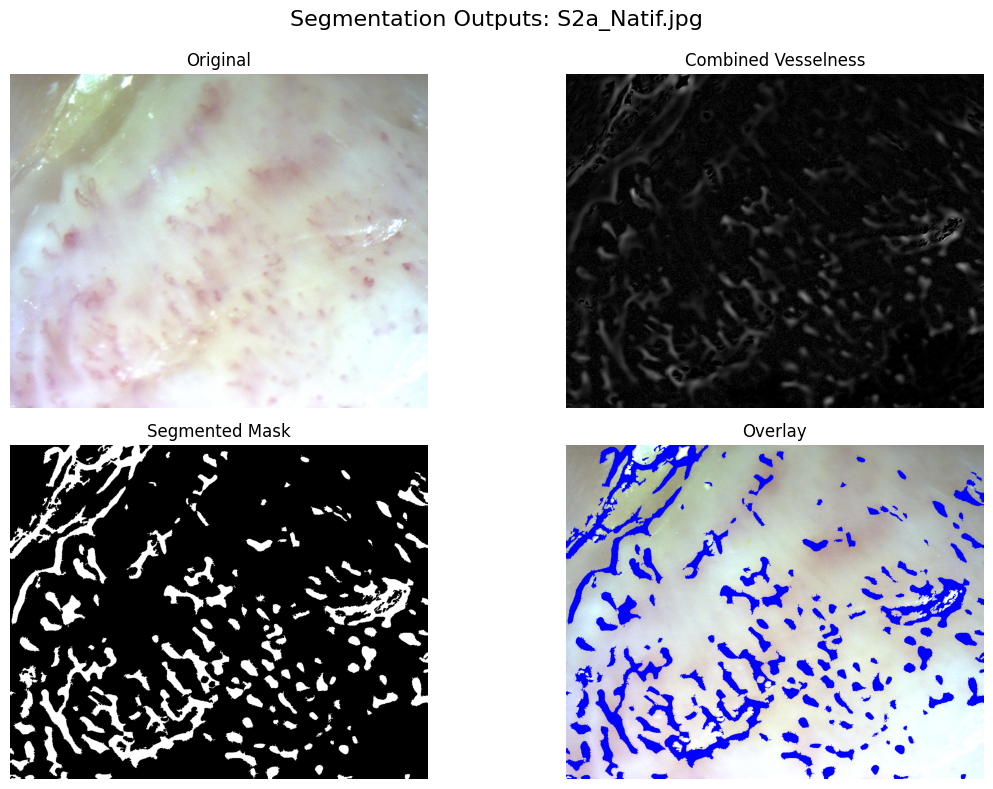

Otsu threshold value: 0.07133982251087001


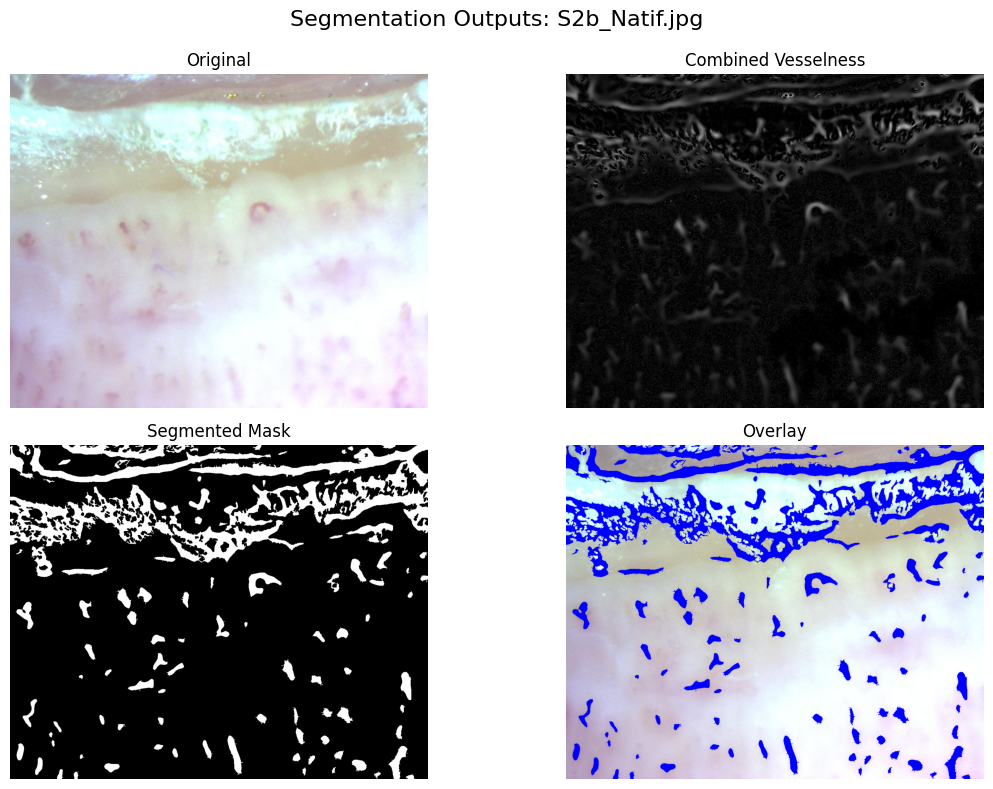

Otsu threshold value: 0.07374356987528925


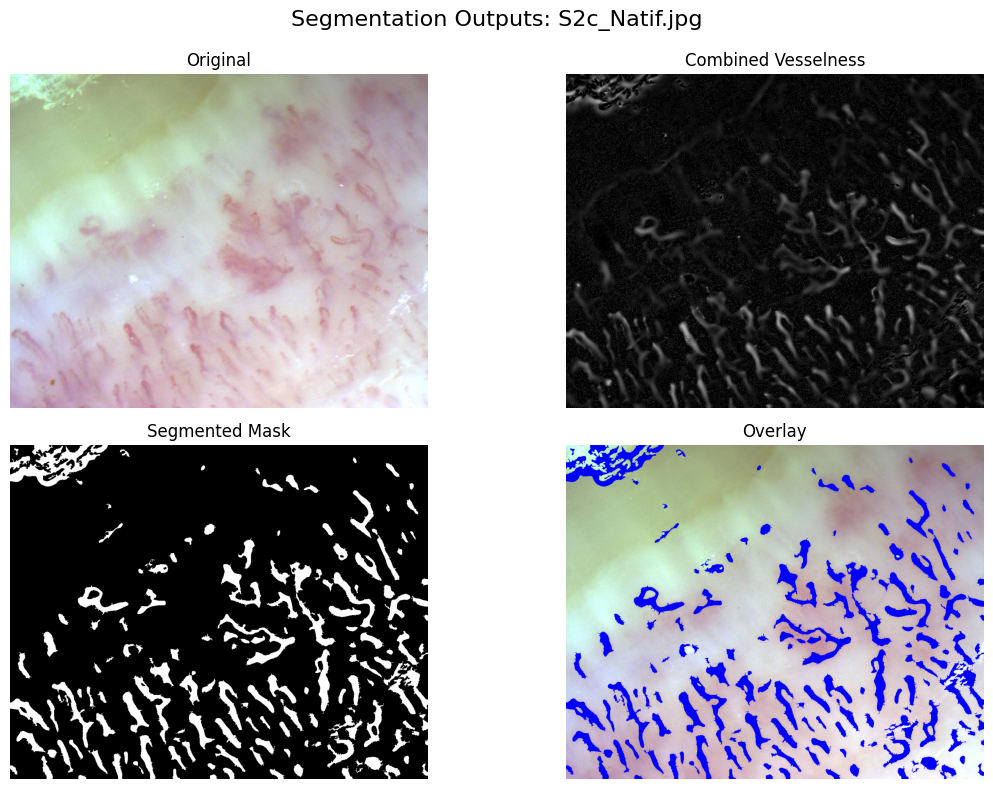

Otsu threshold value: 0.07336929431000774


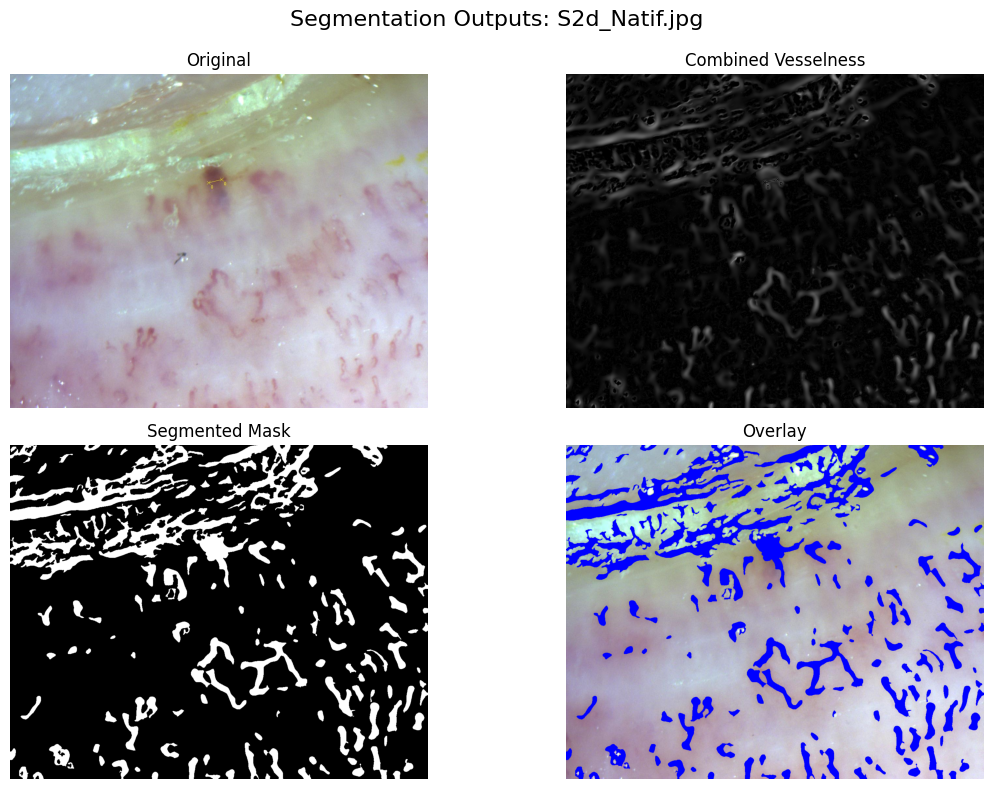

Otsu threshold value: 0.0559823612726195


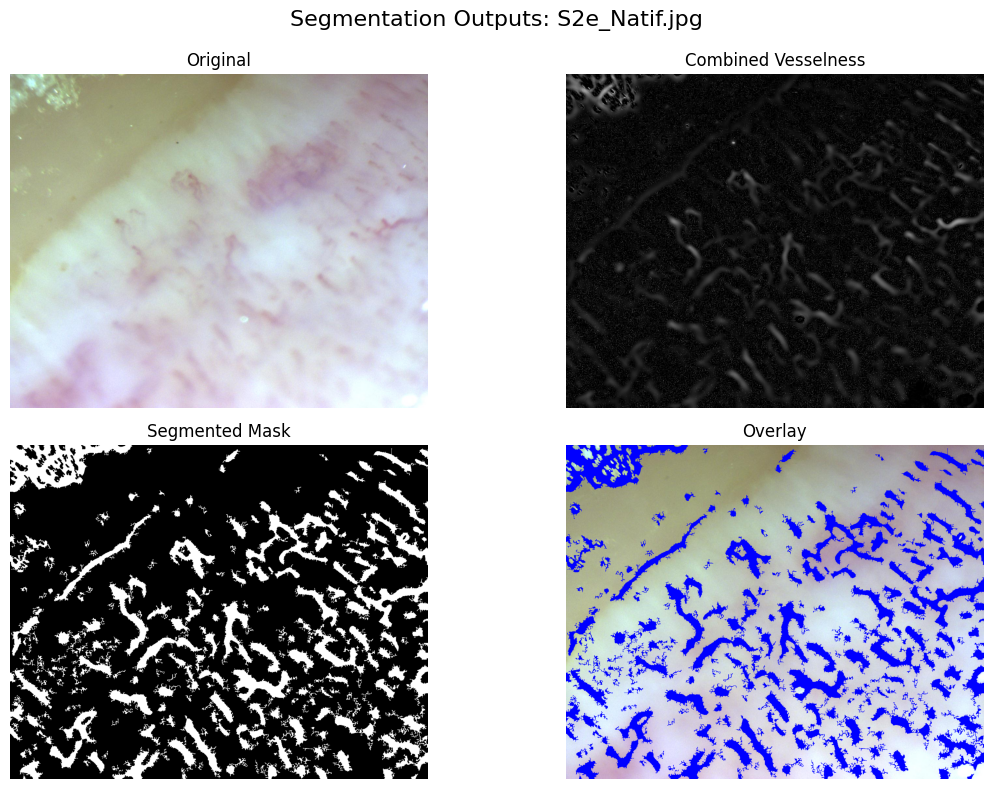

Otsu threshold value: 0.059724138745080355


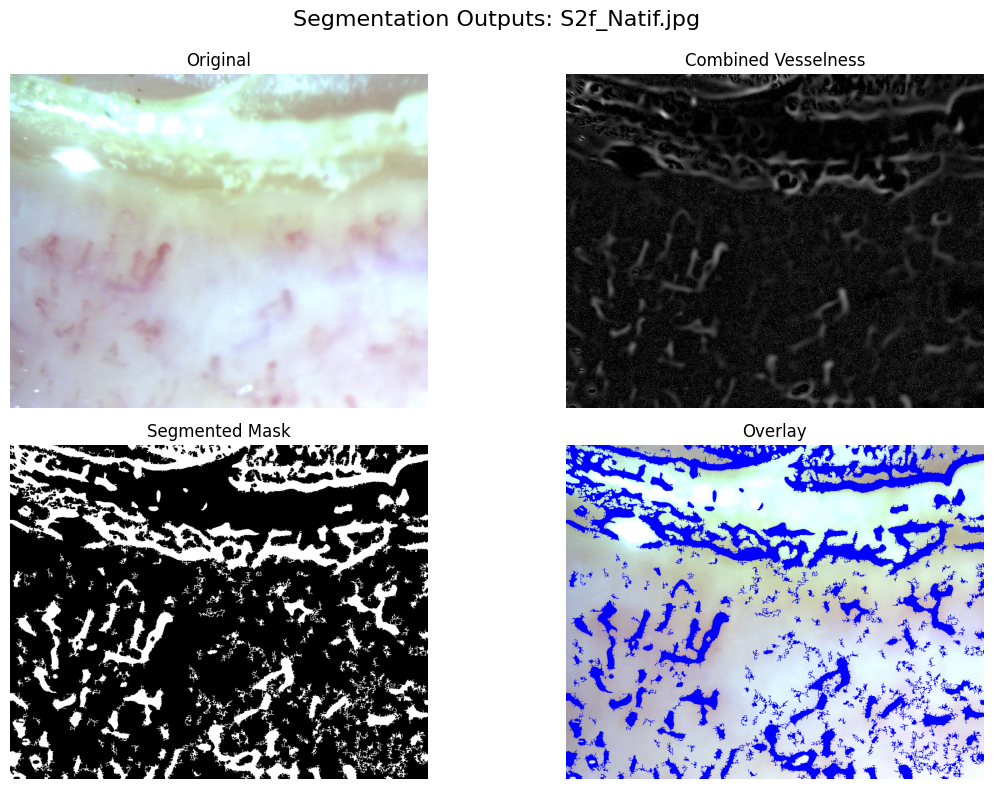

Otsu threshold value: 0.07211305549756811


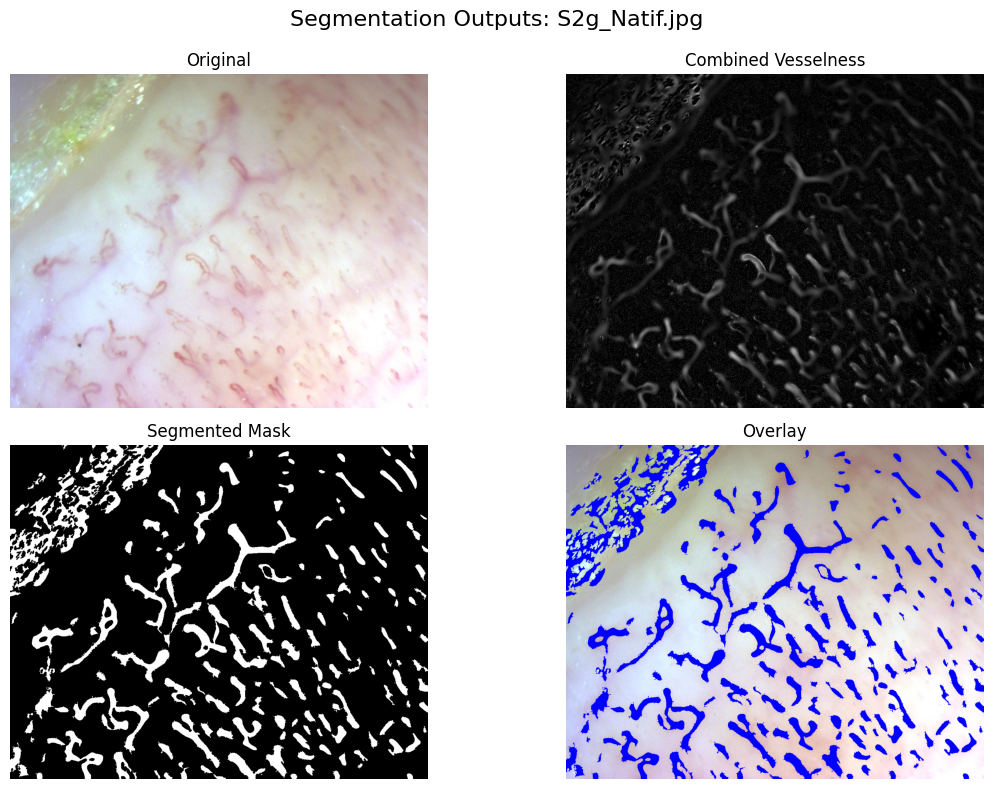

In [4]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, meijering, sato, threshold_otsu
from skimage.morphology import remove_small_objects, closing, square, remove_small_holes
from matplotlib.backends.backend_pdf import PdfPages


# Path to your S2_Native folder
folder_path = 'Dataset/Native/S2_Native'

# New organized output folders
base_output = 'Segmented'
segmentation_folder = os.path.join(base_output, 'S2_Native_Segmentation')

original_folder = os.path.join(segmentation_folder, 'Original')
vesselness_folder = os.path.join(segmentation_folder, 'Vesselness')
mask_folder = os.path.join(segmentation_folder, 'Masks')
overlay_folder = os.path.join(segmentation_folder, 'Overlays')

# Create folders
os.makedirs(original_folder, exist_ok=True)
os.makedirs(vesselness_folder, exist_ok=True)
os.makedirs(mask_folder, exist_ok=True)
os.makedirs(overlay_folder, exist_ok=True)

# Supported image formats
supported_extensions = ('.png', '.jpg', '.jpeg', '.tif')
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(supported_extensions)]

def segment_capillaries(img):
    # Convert to grayscale
    if len(img.shape) == 3:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img

    # Median filtering
    # img_denoised = cv2.medianBlur(img_gray, 5)

    # Apply CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    img_clahe = clahe.apply(img_gray)

    # Normalize to [0, 1]
    img_rescale = img_clahe / 255.0

    # Vessel enhancement filters
    v_frangi = frangi(img_rescale)
    v_sato = sato(img_rescale)
    v_meijering = meijering(img_rescale)

    # Combine vessel responses
    vessels = (v_frangi + v_sato + v_meijering) / 3.0

    # Otsu threshold
    otsu_thresh = threshold_otsu(vessels)
    thresh = vessels > otsu_thresh
    print(f"Otsu threshold value: {otsu_thresh}")

    # Morphological cleaning
    closed = closing(thresh, square(3))
    cleaned = remove_small_objects(closed, min_size=100)
    cleaned = remove_small_holes(cleaned, area_threshold=50)

    return vessels, cleaned

# Process each image
for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    img = cv2.imread(img_path)

    vessels, segmented = segment_capillaries(img)

    # Overlay mask on original image
    overlay = img.copy()
    overlay[segmented.astype(bool)] = [255, 0, 0]  # Red overlay

    # Save original
    cv2.imwrite(os.path.join(original_folder, img_name), img)

    # Save vesselness
    vesselness_uint8 = (vessels * 255).astype(np.uint8)
    cv2.imwrite(os.path.join(vesselness_folder, img_name), vesselness_uint8)

    # Save binary mask
    cv2.imwrite(os.path.join(mask_folder, img_name), (segmented * 255).astype(np.uint8))

    # Save overlay
    cv2.imwrite(os.path.join(overlay_folder, img_name), overlay)

    # Optional: Display results
    plt.figure(figsize=(12, 8))
    plt.suptitle(f"Segmentation Outputs: {img_name}", fontsize=16)

    plt.subplot(2, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(vessels, cmap='gray')
    plt.title("Combined Vesselness")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(segmented, cmap='gray')
    plt.title("Segmented Mask")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title("Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()


# S3_Native

Otsu threshold value: 0.06341672696230077


C:\Users\Dani\AppData\Local\Temp\ipykernel_14444\2213331430.py:63: FutureWarning: `square` is deprecated since version 0.25 and will be removed in version 0.27. Use `skimage.morphology.footprint_rectangle` instead.
  closed = closing(thresh, square(3))


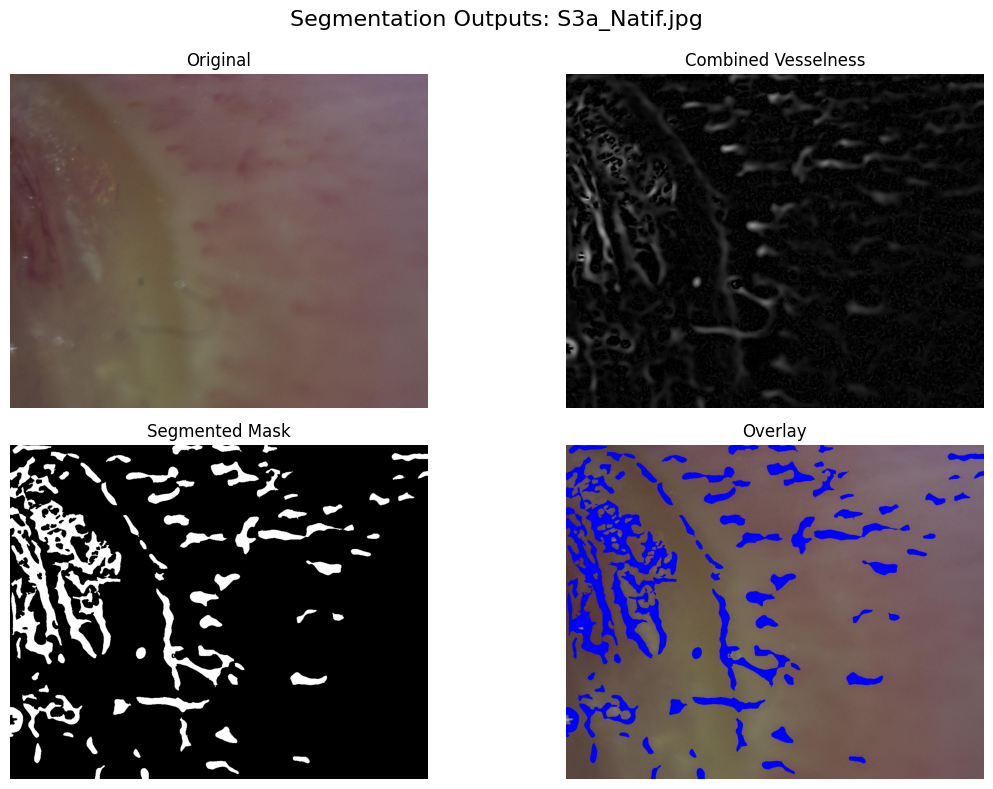

Otsu threshold value: 0.05496092073131165


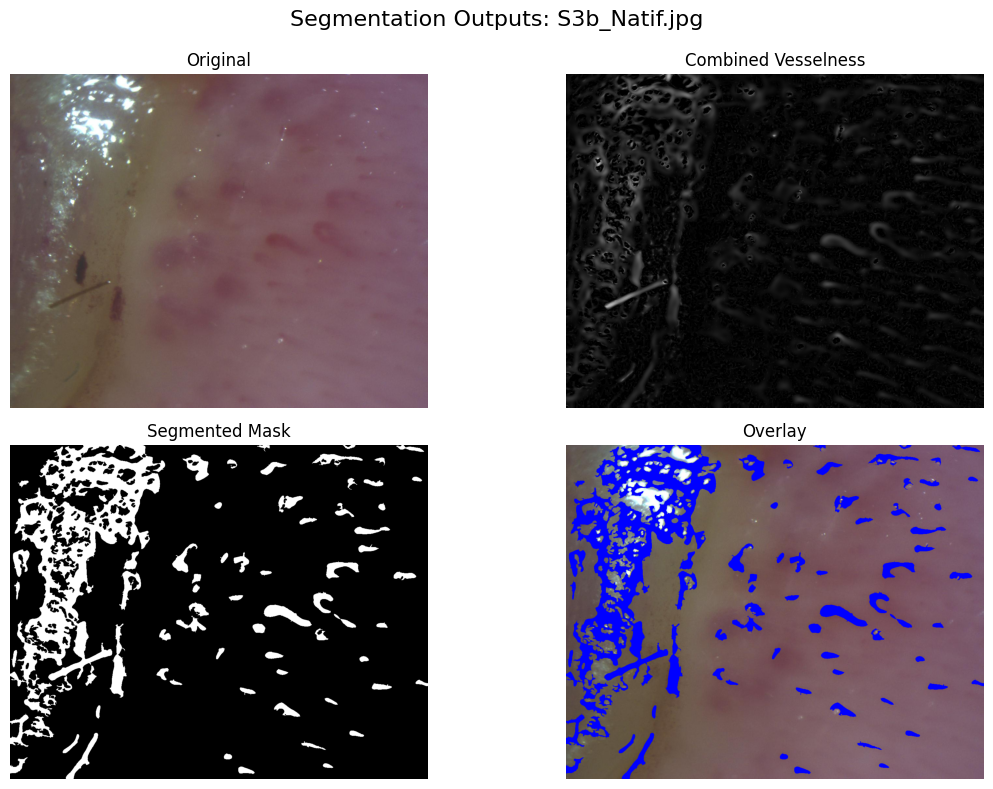

Otsu threshold value: 0.05400918077883657


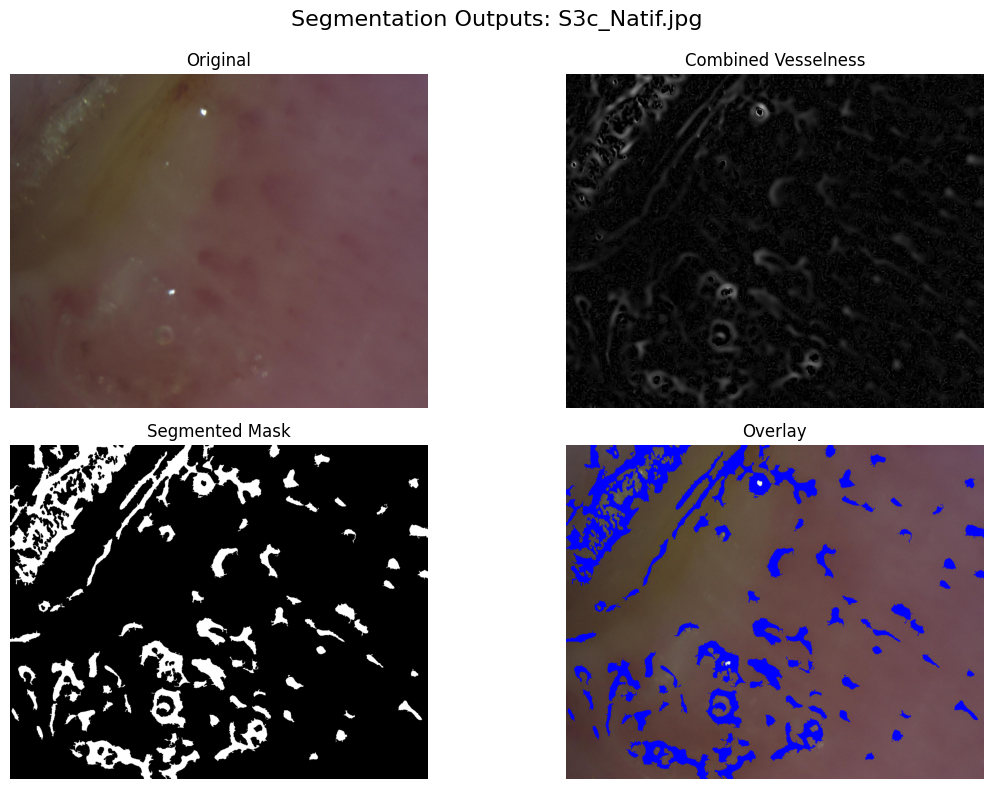

Otsu threshold value: 0.06238782433337621


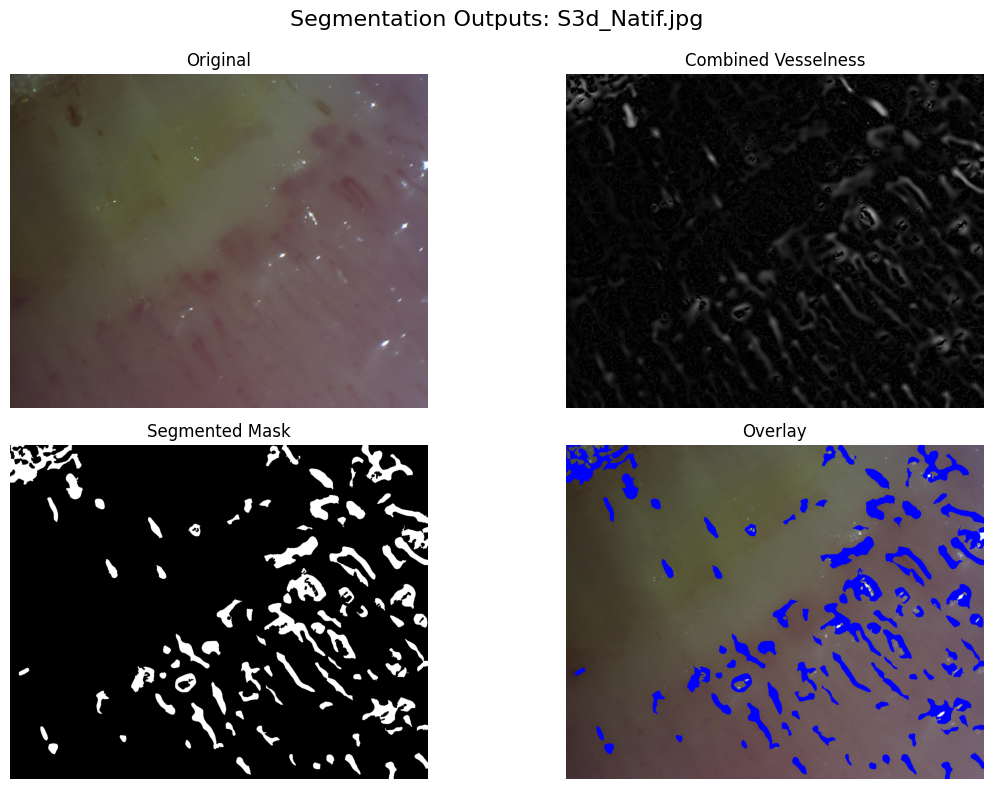

Otsu threshold value: 0.06906606153969577


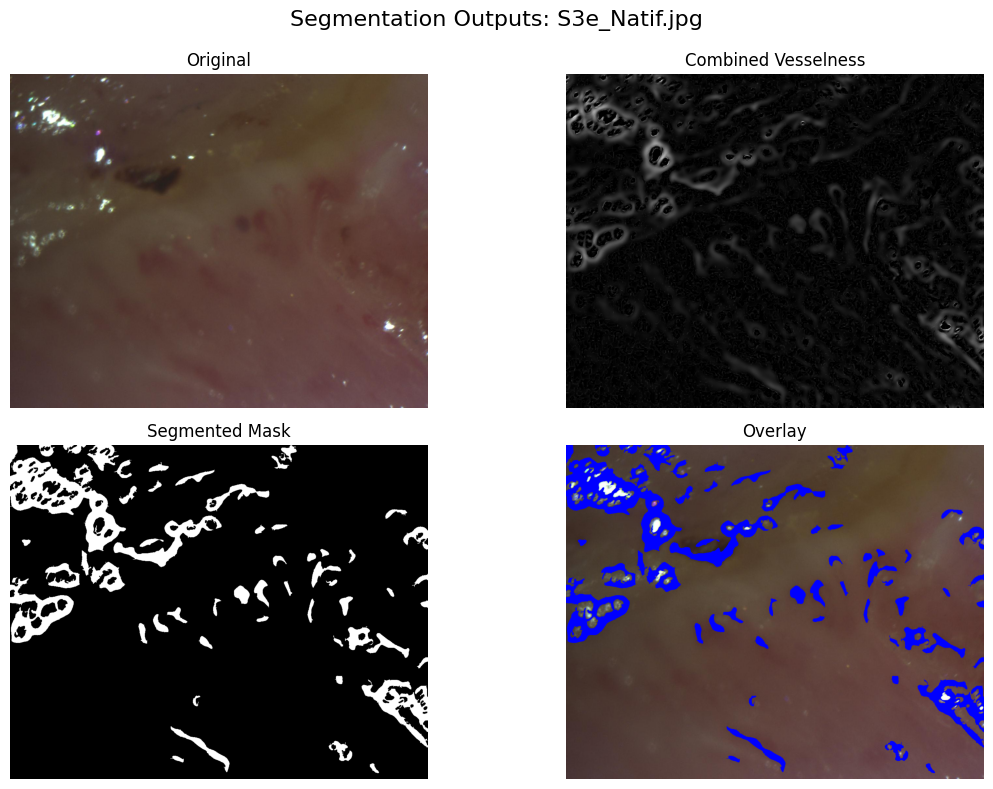

Otsu threshold value: 0.061631582167362434


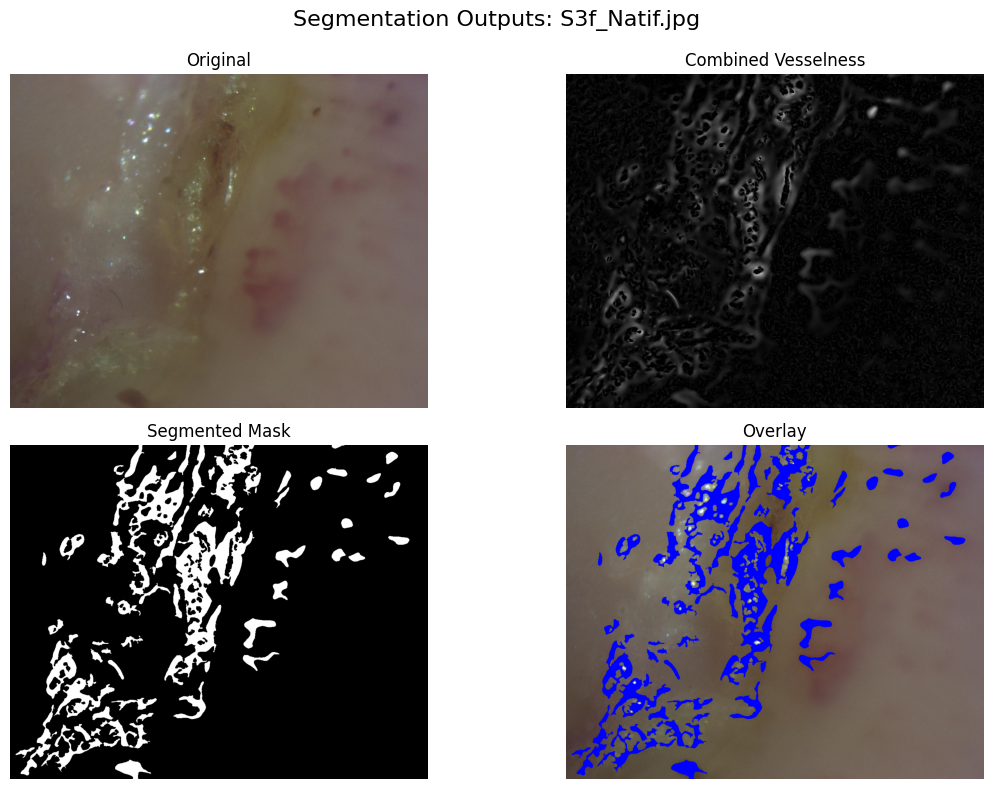

Otsu threshold value: 0.05078268680443498


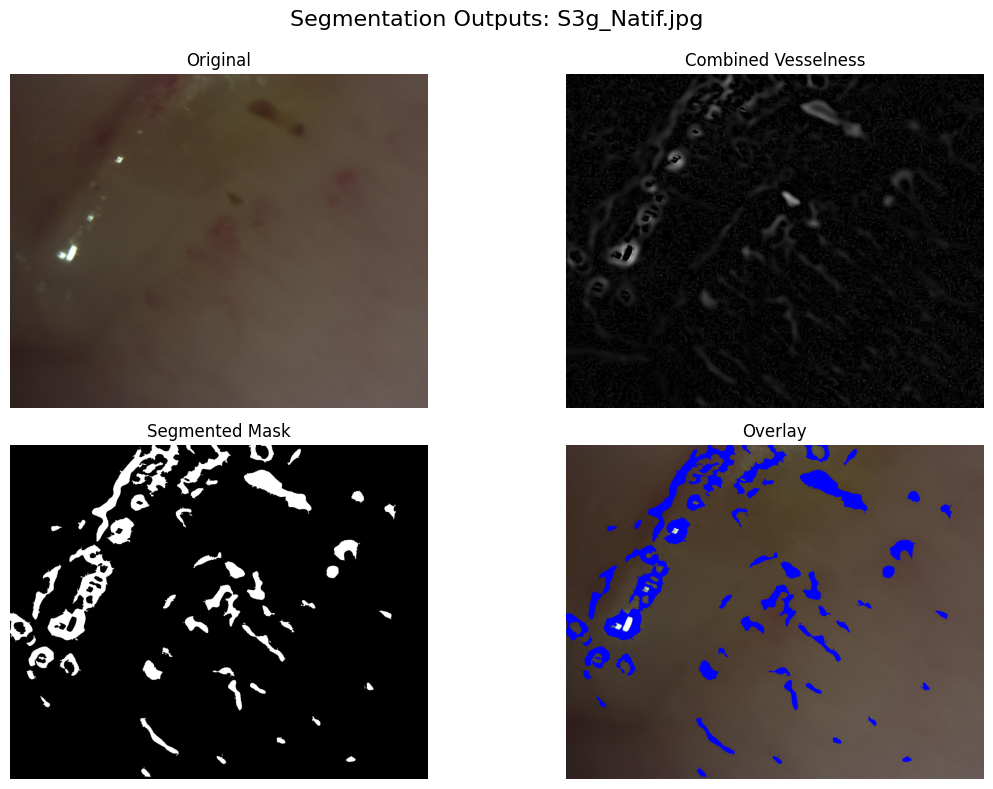

Otsu threshold value: 0.04929282305506416


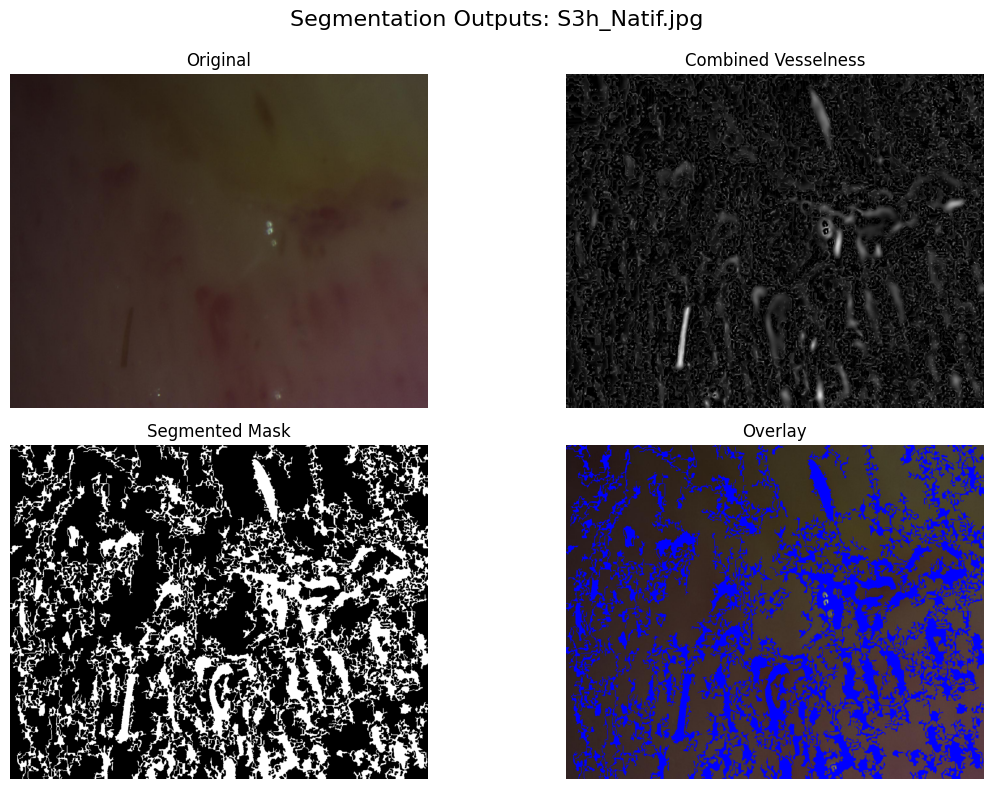

Otsu threshold value: 0.041393656001799825


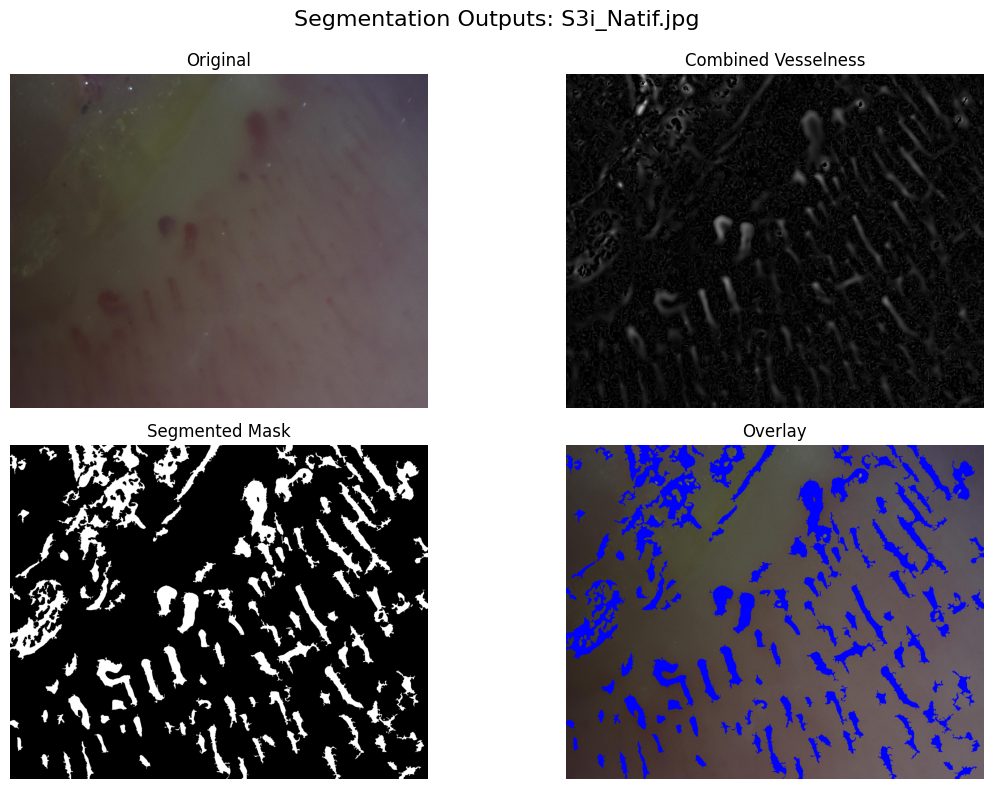

Otsu threshold value: 0.06024643765834901


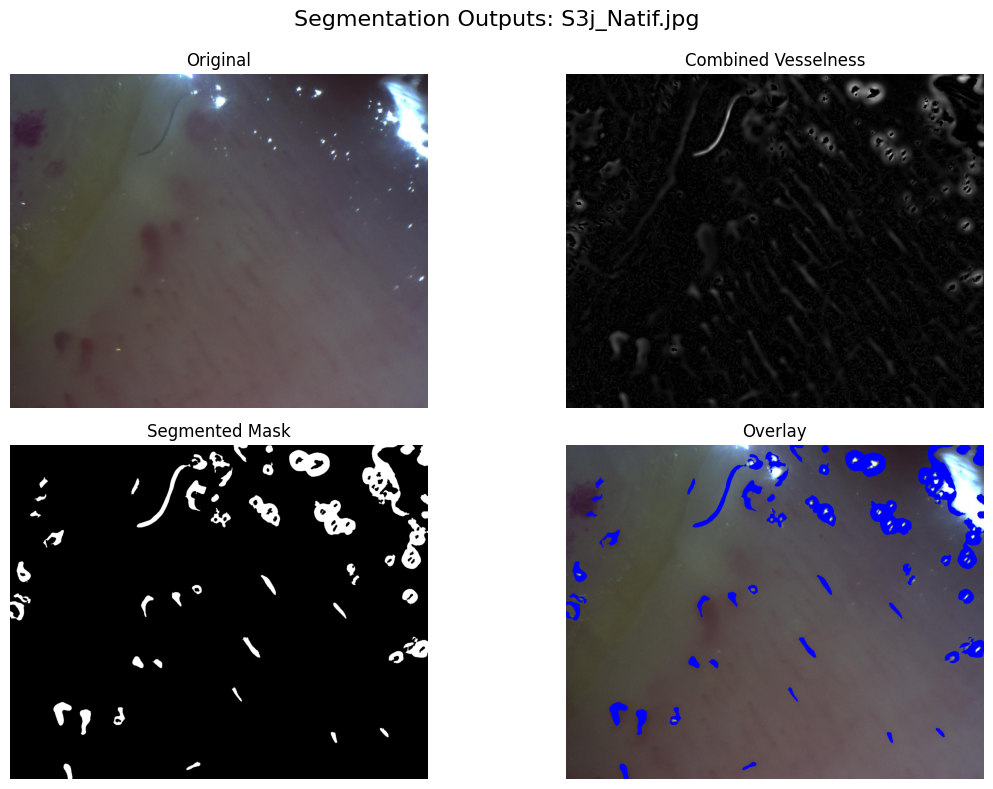

In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import frangi, meijering, sato, threshold_otsu
from skimage.morphology import remove_small_objects, closing, square, remove_small_holes
from matplotlib.backends.backend_pdf import PdfPages


# Path to your S3_Native folder
folder_path = 'Dataset/Native/S3_Native'

# New organized output folders
base_output = 'Segmented'
segmentation_folder = os.path.join(base_output, 'S3_Native_Segmentation')

original_folder = os.path.join(segmentation_folder, 'Original')
vesselness_folder = os.path.join(segmentation_folder, 'Vesselness')
mask_folder = os.path.join(segmentation_folder, 'Masks')
overlay_folder = os.path.join(segmentation_folder, 'Overlays')

# Create folders
os.makedirs(original_folder, exist_ok=True)
os.makedirs(vesselness_folder, exist_ok=True)
os.makedirs(mask_folder, exist_ok=True)
os.makedirs(overlay_folder, exist_ok=True)

# Supported image formats
supported_extensions = ('.png', '.jpg', '.jpeg', '.tif')
image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(supported_extensions)]

def segment_capillaries(img):
    # Convert to grayscale
    if len(img.shape) == 3:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img

    # Median filtering
    img_denoised = cv2.medianBlur(img_gray, 5)

    # Apply CLAHE
    clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(4, 4))
    img_clahe = clahe.apply(img_denoised)

    # Normalize to [0, 1]
    img_rescale = img_clahe / 255.0

    # Vessel enhancement filters
    v_frangi = frangi(img_rescale)
    v_sato = sato(img_rescale)
    v_meijering = meijering(img_rescale)

    # Combine vessel responses
    vessels = (v_frangi + v_sato + v_meijering) / 3.0

    # Otsu threshold
    otsu_thresh = threshold_otsu(vessels)
    thresh = vessels > otsu_thresh
    print(f"Otsu threshold value: {otsu_thresh}")

    # Morphological cleaning
    closed = closing(thresh, square(3))
    cleaned = remove_small_objects(closed, min_size=300)
    cleaned = remove_small_holes(cleaned, area_threshold=70)

    return vessels, cleaned

# Process each image
for img_name in image_files:
    img_path = os.path.join(folder_path, img_name)
    img = cv2.imread(img_path)

    vessels, segmented = segment_capillaries(img)

    # Overlay mask on original image
    overlay = img.copy()
    overlay[segmented.astype(bool)] = [255, 0, 0]  # Red overlay

    # Save original
    cv2.imwrite(os.path.join(original_folder, img_name), img)

    # Save vesselness
    vesselness_uint8 = (vessels * 255).astype(np.uint8)
    cv2.imwrite(os.path.join(vesselness_folder, img_name), vesselness_uint8)

    # Save binary mask
    cv2.imwrite(os.path.join(mask_folder, img_name), (segmented * 255).astype(np.uint8))

    # Save overlay
    cv2.imwrite(os.path.join(overlay_folder, img_name), overlay)

    # Optional: Display results
    plt.figure(figsize=(12, 8))
    plt.suptitle(f"Segmentation Outputs: {img_name}", fontsize=16)

    plt.subplot(2, 2, 1)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.imshow(vessels, cmap='gray')
    plt.title("Combined Vesselness")
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.imshow(segmented, cmap='gray')
    plt.title("Segmented Mask")
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title("Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
